# Data:

In [1]:
import pandas as pd

In [2]:
#%%time

#df_news_final_project = pd.read_parquet('https://storage.googleapis.com/msca-bdp-data-open/news_final_project/news_final_project.parquet', engine='pyarrow')
#df_news_final_project.shape

In [3]:
# save df_news_final_project as a parquet file
#df_news_final_project.to_parquet('news_final_project.parquet(5_3)', engine='pyarrow')

# Packages:

In [4]:
import sys
print(sys.version)

3.9.13 (main, Aug 25 2022, 23:51:50) [MSC v.1916 64 bit (AMD64)]


In [5]:
!pip install pyarrow

import os
import time
import math
import re
from pprint import pprint
from textblob import TextBlob
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt


import nltk as nltk
from nltk.corpus import stopwords
# from nltk.stem.wordnet import WordNetLemmatizer
import spacy
import multiprocessing
import string


import gensim
from gensim import corpora, models
from gensim.models.ldamulticore import LdaMulticore
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel

# import pyLDAvis.gensim
import pyLDAvis
import pyLDAvis.gensim_models as gensimvis
pyLDAvis.enable_notebook()

from transformers import pipeline
import torch

# import Counter
from collections import Counter


from sklearn.feature_extraction.text import TfidfVectorizer
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

c:\Users\skyxt\anaconda3\lib\site-packages\past\builtins\misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload


In [6]:
import warnings

# warnings.simplefilter('once')
warnings.simplefilter('ignore')
# warnings.filterwarnings("ignore", category=FutureWarning)
# warnings.filterwarnings("ignore", category=DeprecationWarning)
# warnings.filterwarnings(action='ignore', category=UserWarning, module='gensim')

In [7]:
num_processors = multiprocessing.cpu_count()
num_processors

workers = num_processors-1

print(f'Using {workers} workers')

Using 15 workers


In [8]:
start_time = time.time()

def tic():
    global start_time 
    start_time = time.time()

def tac():
    t_sec = round(time.time() - start_time)
    (t_min, t_sec) = divmod(t_sec,60)
    (t_hour,t_min) = divmod(t_min,60) 
    print(f'Execution time to calculate for topic {k}: {t_hour}hour:{t_min}min:{t_sec}sec'.format(t_hour,t_min,t_sec))

In [9]:
import sys
import os

import re
import string

import nltk as nltk
from nltk.corpus import stopwords
from nltk.stem.wordnet import WordNetLemmatizer

print('Python Version: ' + sys.version)

Python Version: 3.9.13 (main, Aug 25 2022, 23:51:50) [MSC v.1916 64 bit (AMD64)]


In [10]:
#!pip uninstall protobuf

In [11]:
#!pip uninstall tensorflow
#!pip uninstall tensorflow-gpu
#!pip install --upgrade --force-reinstall tensorflow-gpu

In [12]:
#!pip install tensorflow-gpu
#! pip install tensorflow
#! pip install tensorflow-directml-plugin
import tensorflow as tf
print('TensorFlow Version: ' + tf.__version__)

TensorFlow Version: 2.10.0


In [13]:
#Verify we got CPU + GPU or only CPU
tf.config.list_physical_devices()

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'),
 PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU'),
 PhysicalDevice(name='/physical_device:GPU:1', device_type='GPU')]

In [14]:
#!pip install ktrain --upgrade
import ktrain

print('Ktrain Version: ' + ktrain.__version__)

Ktrain Version: 0.37.0


# Run below if you don't have the packages installed

In [16]:
# Run everything above this line before running the next cell

# Identify top reasons for successful data science / AI initiatives (sentiment analysis) - these can be related to technology maturity, people, data availability, etc.
    -Suggest why certain types of applications succeed vs other fail
    -Plot a timeline to illustrate how the sentiment is changing over time

# K-train (Do not use LDA)

In [17]:
# read df_top_tfidf_sentiment parquet file
df_top_tfidf_sentiment = pd.read_parquet('df_ready', engine='pyarrow')

In [18]:
df_top_tfidf_sentiment.head(5)

,url,date,language,title,text,split,split_cleaned,missing,text_cleaned,polarity,subjectivity,sentiment,entities,sentiment_agg
0,http://en.people.cn/n3/2021/0318/c90000-983012...,2021-03-18,en,Artificial intelligence improves parking effic...,Artificial intelligence improves parking eff...,[ Artificial intelligence improves parking ef...,[ Artificial intelligence improves parking ef...,[ a Beijing based leading smart parking soluti...,Artificial intelligence improves parking effic...,0.079344,0.439964,"[POSITIVE, POSITIVE, NEGATIVE, NEGATIVE, POSIT...","[[Chinese, NORP], [Chinese, NORP], [Japanese, ...",POSITIVE
1,http://newsparliament.com/2020/02/27/children-...,2020-02-27,en,Children With Autism Saw Their Learning and So...,Children With Autism Saw Their Learning and S...,[ Children With Autism Saw Their Learning and ...,[ Children With Autism Saw Their Learning and ...,[ Children With Autism Saw Their Learning and ...,Children With Autism Saw Their Learning and So...,0.078180,0.396345,"[NEGATIVE, NEGATIVE, NEGATIVE, POSITIVE, NEGAT...","[[Thursday, DATE], [27 2020, DATE], [Latest Ma...",NEGATIVE
2,http://www.dataweek.co.za/12835r,2021-03-26,en,"Forget ML, AI and Industry 4.0 – obsolescence ...","Forget ML, AI and Industry 4 0 obsolescenc...","[ Forget ML, AI and Industry 4 0 obsolesce...","[ Forget ML, AI and Industry 4 0 obsolesce...","[ Forget ML, AI and Industry 4 0 obsolesce...",Forget ML AI and Industry 4 0 obsolescence sho...,0.191946,0.429703,"[NEGATIVE, NEGATIVE, NEGATIVE, NEGATIVE, POSIT...","[[Forget ML AI, ORG], [26 February 2021, DATE]...",NEGATIVE
3,http://www.homeoffice.consumerelectronicsnet.c...,2021-03-10,en,Strategy Analytics: 71% of Smartphones Sold Gl...,Strategy Analytics 71 of Smartphones Sold ...,[ Strategy Analytics 71 of Smartphones Sold...,[ Smartphones Global Artificial Intelligence ...,[ Strategy Analytics 71 of Smartphones Sold...,Smartphones Global Artificial Intelligence Tec...,0.163568,0.480095,"[POSITIVE, POSITIVE, POSITIVE, POSITIVE, POSIT...","[[2025, DATE], [Artificial Intelligence, ORG],...",POSITIVE
4,http://www.itbusinessnet.com/2020/10/olympus-t...,2020-10-20,en,Olympus to Support Endoscopic AI Diagnosis Edu...,Olympus to Support Endoscopic AI Diagnosis E...,[ Olympus to Support Endoscopic AI Diagnosis ...,"[ Oct 20, 2020 (ACN Newswire) Olympus Co...",[ Olympus to Support Endoscopic AI Diagnosis ...,Oct 20 2020 (ACN Newswire) Olympus Corporation...,0.032763,0.245189,"[POSITIVE, POSITIVE, POSITIVE, NEGATIVE, NEGAT...","[[20 2020, DATE], [ACN Newswire, ORG], [Olympu...",POSITIVE


In [19]:
# valuecount sentiment_agg
df_top_tfidf_sentiment['sentiment_agg'].value_counts()

NEGATIVE    112249
POSITIVE     85765
Name: sentiment_agg, dtype: int64

In [30]:
postive_sentiment = df_top_tfidf_sentiment[df_top_tfidf_sentiment['sentiment_agg'] == 'POSITIVE']
negative_sentiment = df_top_tfidf_sentiment[df_top_tfidf_sentiment['sentiment_agg'] == 'NEGATIVE']

For Positive:

use ktrain:

In [ ]:
texts = postive_sentiment['text_cleaned'].tolist()

In [ ]:
%%time
tm = ktrain.text.get_topic_model(
    texts=texts, 
    n_topics=12, 
    n_features=10000, 
    min_df=5, 
    max_df=0.5, 
    stop_words='english', 
    model_type='lda', 
    lda_max_iter=5, 
    verbose=1)

lang: en
preprocessing texts...
fitting model...
iteration: 1 of max_iter: 5
iteration: 2 of max_iter: 5
iteration: 3 of max_iter: 5
iteration: 4 of max_iter: 5
iteration: 5 of max_iter: 5
done.
Wall time: 4min 3s


In [ ]:
%%time
tm.print_topics()

topic 0 | legal organizations risk email responsible use news privacy facebook leaders
topic 1 | work students people education news state like future university year
topic 2 | health medical healthcare clinical care patient patients research imaging cancer
topic 3 | gray prnewswire press release statements state television reflect station opinions
topic 4 | edge vision computer smart solutions devices applications software power hardware
topic 5 | market growth report analysis players software key corporation forecast trends
topic 6 | news services financial companies digital investment million india billion communications
topic 7 | market report analysis growth research forecast key trends size share
topic 8 | time like use users chatgpt news human digital using experience
topic 9 | learning machine science research cloud energy systems computing models nvidia
topic 10 | policy travel public american sports services transportation estate aviation real
topic 11 | platform customer cus

In [ ]:
%%time
#### Compute the Document-Topic Matrix
tm.build(texts, threshold=0.25)

done.
Wall time: 1min


In [ ]:
%%time
#### Inspect and Visualize Topics
# Let's list the topics by document count:

tm.print_topics(show_counts=True)

topic:8 | count:12782 | time like use users chatgpt news human digital using experience
topic:3 | count:12329 | gray prnewswire press release statements state television reflect station opinions
topic:7 | count:11356 | market report analysis growth research forecast key trends size share
topic:11 | count:8605 | platform customer customers cloud solutions time experience service enterprise capabilities
topic:2 | count:7839 | health medical healthcare clinical care patient patients research imaging cancer
topic:1 | count:6007 | work students people education news state like future university year
topic:9 | count:5290 | learning machine science research cloud energy systems computing models nvidia
topic:5 | count:5039 | market growth report analysis players software key corporation forecast trends
topic:6 | count:4587 | news services financial companies digital investment million india billion communications
topic:4 | count:4325 | edge vision computer smart solutions devices applications 

In [ ]:
%%time
#### Visualize topics
doc_topics=tm.get_doctopics()

Wall time: 127 ms


In [ ]:
%%time
tm.visualize_documents(doc_topics=tm.get_doctopics())

reducing to 2 dimensions...[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 84554 samples in 0.281s...
[t-SNE] Computed neighbors for 84554 samples in 15.026s...
[t-SNE] Computed conditional probabilities for sample 1000 / 84554
[t-SNE] Computed conditional probabilities for sample 2000 / 84554
[t-SNE] Computed conditional probabilities for sample 3000 / 84554
[t-SNE] Computed conditional probabilities for sample 4000 / 84554
[t-SNE] Computed conditional probabilities for sample 5000 / 84554
[t-SNE] Computed conditional probabilities for sample 6000 / 84554
[t-SNE] Computed conditional probabilities for sample 7000 / 84554
[t-SNE] Computed conditional probabilities for sample 8000 / 84554
[t-SNE] Computed conditional probabilities for sample 9000 / 84554
[t-SNE] Computed conditional probabilities for sample 10000 / 84554
[t-SNE] Computed conditional probabilities for sample 11000 / 84554
[t-SNE] Computed conditional probabilities for sample 12000 / 84554
[t-SNE] Computed condi

Loading BokehJS ...

Wall time: 3min


For Negative:

use K-trian:

In [ ]:
%%time
texts = postive_sentiment['text_cleaned'].tolist()

Wall time: 26.7 ms


In [ ]:
%%time
tm = ktrain.text.get_topic_model(
    texts=texts, 
    n_topics=12, 
    n_features=10000, 
    min_df=5, 
    max_df=0.5, 
    stop_words='english', 
    model_type='lda', 
    lda_max_iter=5, 
    verbose=1)

lang: en
preprocessing texts...
fitting model...
iteration: 1 of max_iter: 5
iteration: 2 of max_iter: 5
iteration: 3 of max_iter: 5
iteration: 4 of max_iter: 5
iteration: 5 of max_iter: 5
done.
Wall time: 3min 59s


In [ ]:
%%time
tm.print_topics()

topic 0 | legal organizations risk email responsible use news privacy facebook leaders
topic 1 | work students people education news state like future university year
topic 2 | health medical healthcare clinical care patient patients research imaging cancer
topic 3 | gray prnewswire press release statements state television reflect station opinions
topic 4 | edge vision computer smart solutions devices applications software power hardware
topic 5 | market growth report analysis players software key corporation forecast trends
topic 6 | news services financial companies digital investment million india billion communications
topic 7 | market report analysis growth research forecast key trends size share
topic 8 | time like use users chatgpt news human digital using experience
topic 9 | learning machine science research cloud energy systems computing models nvidia
topic 10 | policy travel public american sports services transportation estate aviation real
topic 11 | platform customer cus

In [ ]:
%%time
#### Compute the Document-Topic Matrix
tm.build(texts, threshold=0.25)

done.
Wall time: 1min 2s


In [ ]:
%%time
#### Inspect and Visualize Topics
# Let's list the topics by document count:

tm.print_topics(show_counts=True)

topic:8 | count:12782 | time like use users chatgpt news human digital using experience
topic:3 | count:12329 | gray prnewswire press release statements state television reflect station opinions
topic:7 | count:11356 | market report analysis growth research forecast key trends size share
topic:11 | count:8605 | platform customer customers cloud solutions time experience service enterprise capabilities
topic:2 | count:7839 | health medical healthcare clinical care patient patients research imaging cancer
topic:1 | count:6007 | work students people education news state like future university year
topic:9 | count:5290 | learning machine science research cloud energy systems computing models nvidia
topic:5 | count:5039 | market growth report analysis players software key corporation forecast trends
topic:6 | count:4587 | news services financial companies digital investment million india billion communications
topic:4 | count:4325 | edge vision computer smart solutions devices applications 

In [ ]:
%%time
#### Visualize topics
doc_topics=tm.get_doctopics()

Wall time: 130 ms


In [ ]:
%%time
tm.visualize_documents(doc_topics=tm.get_doctopics())

reducing to 2 dimensions...[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 84554 samples in 0.100s...
[t-SNE] Computed neighbors for 84554 samples in 14.895s...
[t-SNE] Computed conditional probabilities for sample 1000 / 84554
[t-SNE] Computed conditional probabilities for sample 2000 / 84554
[t-SNE] Computed conditional probabilities for sample 3000 / 84554
[t-SNE] Computed conditional probabilities for sample 4000 / 84554
[t-SNE] Computed conditional probabilities for sample 5000 / 84554
[t-SNE] Computed conditional probabilities for sample 6000 / 84554
[t-SNE] Computed conditional probabilities for sample 7000 / 84554
[t-SNE] Computed conditional probabilities for sample 8000 / 84554
[t-SNE] Computed conditional probabilities for sample 9000 / 84554
[t-SNE] Computed conditional probabilities for sample 10000 / 84554
[t-SNE] Computed conditional probabilities for sample 11000 / 84554
[t-SNE] Computed conditional probabilities for sample 12000 / 84554
[t-SNE] Computed condi

Loading BokehJS ...

Wall time: 3min 2s


# Timeline

Wall time: 47 ms


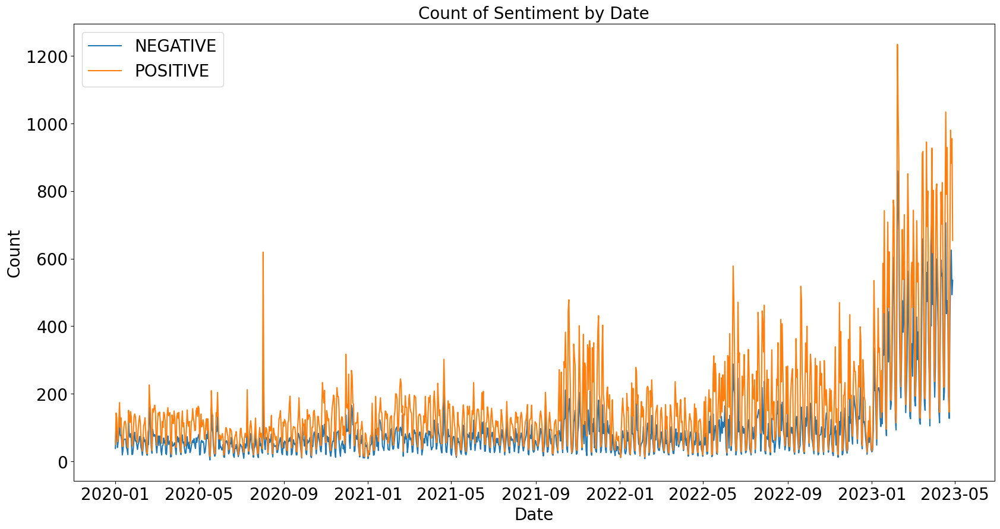

In [38]:
%%time

# plot the count of sentiment_agg by date and by Negative and Positive
df_top_tfidf_sentiment.groupby(['date', 'sentiment_agg']).size().unstack().plot(kind='line', stacked=True, figsize=(20,10))
plt.title('Count of Sentiment by Date', fontsize=20)
plt.xlabel('Date', fontsize=20)
plt.ylabel('Count', fontsize=20)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.legend(fontsize=20)

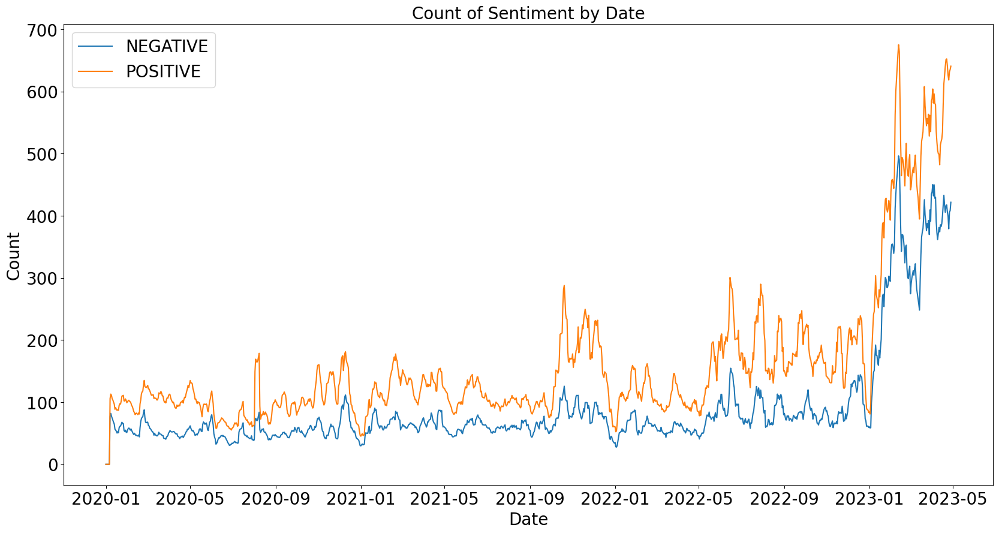

In [40]:
# make the line smoother with less fluctuation
df_top_tfidf_sentiment.groupby(['date', 'sentiment_agg']).size().unstack().rolling(7).mean().plot(kind='line', stacked=True, figsize=(20,10))
plt.title('Count of Sentiment by Date', fontsize=20)
plt.xlabel('Date', fontsize=20)
plt.ylabel('Count', fontsize=20)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.legend(fontsize=20)

# 

# Identify new technologies and AI solutions that might be affecting the landscape of data science applications
    -Plot a timeline to illustrate the introduction of some of these technologies

1. Create a list of tech names, and try to find the tech names that are inside the news articles.

2. Then, draw the timeline which take the account of it first appearing in these news.

In [27]:
technology_names = [
    "IntelliVision","SmartSense","DeepMind","CogniTech","NeuroBot","AI Analyzer","SentiSense","RoboGenius","CognitiveHub","SynthAI","IntelliNet",
    "MindLink","SmartBrain","NeuroSense","GeneticAI","DataWhiz","TechVision","AI Assist","NeuroLogic","RoboVision","CogniSys","SmartAI","IntelliBot",
    "SentiTech","DeepSense","CognitiveGen","NeuroLink","AI Master","DataMind","TechGenius","IntelliSense","Chatbot","ChatGPT","ChatAI","ChatSense",
    "ImageAI","ImageSense","ImageVision","ImageGenius","ImageBot","ImageMaster","ImageNet","ImageWhiz","ImageLogic","ImageLink","ImageGen","ImageTech",
    "VoiceAI","VoiceSense","VoiceVision","VoiceGenius","VoiceBot","VoiceMaster","VoiceNet","VoiceWhiz","VoiceLogic","VoiceLink","VoiceGen","VoiceTech",
    "Siri", "Alexa", "Google Assistant", "Cortana", "Bixby", "DuerOS", "Xiaoice", "Alibaba", "Tmall Genie", "AliGenie", "AliMe", "Ali Xiaomi", "Xiaomi",
    "Stability Ai", "Deepbrain Chain", "SingularityNET", "Neuromation", "Matrix AI Network", "NeuroChain", "Neurotoken", "Neuromation", "Neurogress",
    "Deepbrain AI", "GPT-4", "GPT-3", "GPT-2", "GPT-1", "Quantum AI", "Quantum Computing", "Quantum Machine Learning", "Quantum Deep Learning", "Quantum Neural Network",
    "Quantum Computing", "Quantum Machine Learning", "Quantum Deep Learning", "Quantum Neural Network", "Quantum AI", "Quantum AI", "Quantum AI", "Quantum AI",
    "Natural language generation", "Speech recognition", "Virtual agents", "Machine learning platforms", "AI-optimized hardware", "Decision management",
    "vitual assistant","virtual agent", "Decision Management", "Biometrics", "Robotic process automation", "Peer-to-peer network", "Deep Learning Platforms",
    "AL-optimized hardware", "Decision Management", "Biometrics", "Robotic process automation", "Peer-to-peer network", "Deep Learning Platforms",
]

# remove duplicates
technology_names = list(set(technology_names))

len(technology_names)

104

In [41]:
# remove names that are not in the text
technology_names = [name for name in technology_names if name.lower() in ' '.join(postive_sentiment['text']).lower()]

len(technology_names)

61

In [47]:
# get the count for each technology name
technology_names_count = [postive_sentiment['text'].str.count(name).sum() for name in technology_names]

# create a dataframe

df_technology_names = pd.DataFrame({'technology_names': technology_names, 'technology_names_count': technology_names_count})

# sort the dataframe by technology_names_count
df_technology_names = df_technology_names.sort_values(by='technology_names_count', ascending=False)

# romove rows with technology_names_count = 0
df_technology_names = df_technology_names[df_technology_names['technology_names_count'] > 0]

len(df_technology_names)

49

In [49]:
df_technology_names

,technology_names,technology_names_count
43,ChatGPT,33405
13,Biometrics,6246
41,Chatbot,4996
9,Alexa,4018
4,DeepMind,2779
6,Alibaba,2563
31,Deepbrain AI,2497
8,AI Assist,2105
59,Quantum Computing,1597
5,Siri,988


<AxesSubplot:xlabel='technology_names'>

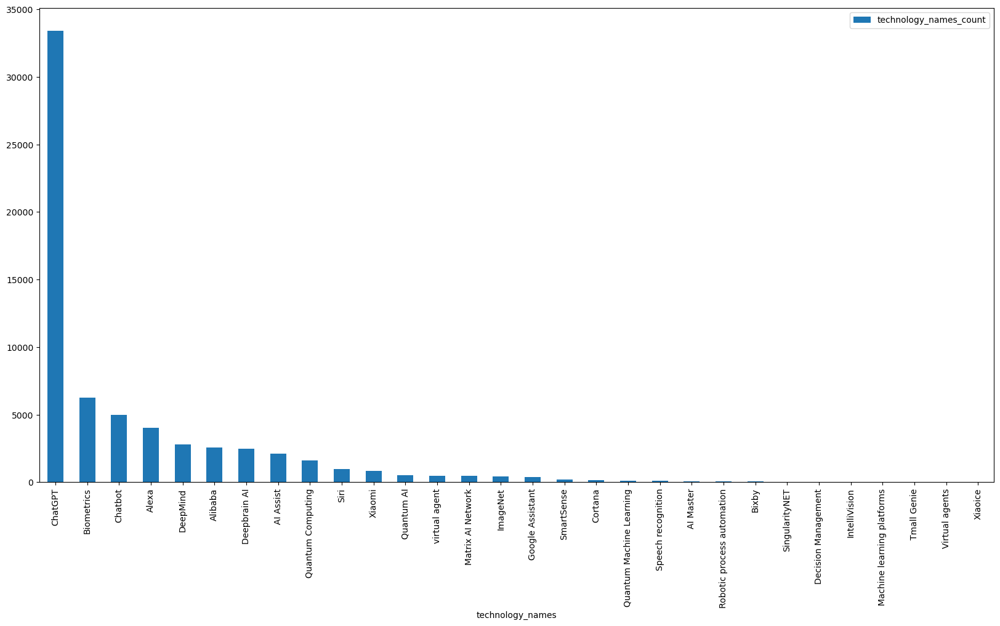

In [50]:
# plot the top 20 technology names

df_technology_names.head(30).plot.bar(x='technology_names', y='technology_names_count', figsize=(20,10))

In [51]:
# draw a timeline for each technology name that it first appears in the text

# create a dataframe to store the timeline for each technology name
df_technology_names_timeline = pd.DataFrame(columns=['technology_names', 'timeline'])

# loop through each technology name
for name in df_technology_names['technology_names']:
    # get the timeline for each technology name
    df_technology_names_timeline = df_technology_names_timeline.append({'technology_names': name, 'timeline': postive_sentiment[postive_sentiment['text'].str.contains(name)]['date'].min()}, ignore_index=True)

df_technology_names_timeline

,technology_names,timeline
0,ChatGPT,2022-12-02
1,Biometrics,2020-01-03
2,Chatbot,2020-01-02
3,Alexa,2020-01-01
4,DeepMind,2020-01-02
5,Alibaba,2020-01-01
6,Deepbrain AI,2021-10-07
7,AI Assist,2020-01-09
8,Quantum Computing,2020-01-06
9,Siri,2020-01-01


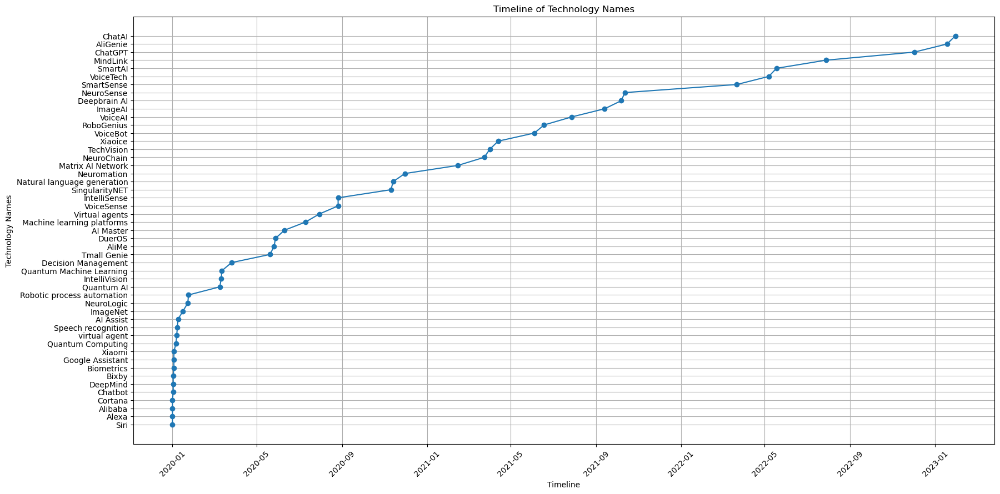

In [58]:
# Convert timeline to datetime format
df_technology_names_timeline['timeline'] = pd.to_datetime(df_technology_names_timeline['timeline'])

# Sort the DataFrame by timeline
df = df_technology_names_timeline.sort_values(by='timeline')

# Plotting the timeline
plt.figure(figsize=(20, 10))
plt.plot(df['timeline'], df['technology_names'], marker='o')
plt.xticks(rotation=45)
plt.xlabel('Timeline')
plt.ylabel('Technology Names')
plt.title('Timeline of Technology Names')
plt.grid(True)

# Demonstrate what companies, academic institutions and government entities can do to accelerate the development of these transformative capabilities

1. Find out the articles that have companies, academic institutions and government.

2. Get all positive sentiments.

3. Check the counts of new techs thats being mentioned and these new techs would be focused for these entities.

4. Do topic modeling if needed.

# Find out ORGs:

In [134]:
# read df_top_tfidf_sentiment parquet file
df_top_tfidf_sentiment = pd.read_parquet('df_ready', engine='pyarrow')

In [135]:
# increase the column width
pd.set_option('display.max_colwidth', 200)
df_top_tfidf_sentiment['entities']

0         [[Chinese, NORP], [Chinese, NORP], [Japanese, NORP], [French, NORP], [Spanish, NORP], [Russian Arabic Korean, NORP], [German, NORP], [Portuguese, NORP], [Thursday, DATE], [March 18, DATE], [2021, ...
1         [[Thursday, DATE], [27 2020, DATE], [Latest Mansplaining, ORG], [Comments, ORG], [February 27 2020, DATE], [the U S, GPE], [Italy, GPE], [27 2020, DATE], [February 27 2020, DATE], [seven, CARDINAL...
2         [[Forget ML AI, ORG], [26 February 2021, DATE], [Test Rework Solutions Dataweek Home, LAW], [PDF EMP Handbook Subscribe Advertise Categories Editors Choice Multimedia, ORG], [Signal LSI Circuit Sy...
3         [[2025, DATE], [Artificial Intelligence, ORG], [AI, ORG], [AI, ORG], [Edge AI, ORG], [Strategy Analytics, PERSON], [71, CARDINAL], [2021, DATE], [AI, PERSON], [Ville Petteri, PERSON], [AI, ORG], [...
4         [[20 2020, DATE], [ACN Newswire, ORG], [Olympus Corporation, ORG], [the Ministry of Internal Affairs and Communications, ORG], [MIC, ORG], [Survey Stu

In [136]:
entity_types = set()
for sublist in df_top_tfidf_sentiment['entities']:
    for pair in sublist:
        entity_type = pair[1]
        entity_types.add(entity_type)

print(entity_types)

{'NORP', 'LAW', 'MONEY', 'TIME', 'EVENT', 'ORG', 'CARDINAL', 'ORDINAL', 'PERSON', 'PRODUCT', 'LANGUAGE', 'WORK_OF_ART', 'GPE', 'DATE', 'PERCENT', 'QUANTITY', 'LOC', 'FAC'}


In [137]:
# keep ORG, GPE, PRODUCT, LOC, PERSON, FAC in the entities column
df_top_tfidf_sentiment['entities'] = df_top_tfidf_sentiment['entities'].apply(lambda x: [pair for pair in x if pair[1] in ['ORG']])

entity_types = set()
for sublist in df_top_tfidf_sentiment['entities']:
    for pair in sublist:
        entity_type = pair[1]
        entity_types.add(entity_type)

print(entity_types)

{'ORG'}


In [138]:
# get top 20 entities for 'ORG'
df_top_tfidf_sentiment['entities'] = df_top_tfidf_sentiment['entities'].apply(lambda x: [pair[0] for pair in x])

# get the count for each entity
entity_count = Counter([entity for sublist in df_top_tfidf_sentiment['entities'] for entity in sublist])

# create a dataframe
df_entity_count = pd.DataFrame({'entity': entity_count.keys(), 'count': entity_count.values()})

# sort the dataframe by count
df_entity_count = df_entity_count.sort_values(by='count', ascending=False)

In [143]:
# sort df_entity_count by count
df_entity_count = df_entity_count.sort_values(by='count', ascending=False)
df_entity_count.head(30)

,entity,count
466106,Microsoft,76750
321735,Google,73949
356886,IBM,25668
58381,Amazon,20934
32453,AP,19113
274887,Forecast,17229
109442,Bard,17077
68082,Apple,14928
119522,Bing,12701
382005,Intel,11246


In [140]:
# combine Gray Television Inc,Gray Media Group,Gray Media Group Inc Station, and Gray Media Group Inc to Gray Media Group (same row)
df_entity_count.loc[df_entity_count['entity'] == 'Gray Television Inc', 'entity'] = 'Gray Media Group'
df_entity_count.loc[df_entity_count['entity'] == 'Gray Media Group Inc Station', 'entity'] = 'Gray Media Group'
df_entity_count.loc[df_entity_count['entity'] == 'Gray Media Group Inc', 'entity'] = 'Gray Media Group'

In [141]:
# make all Gray Media Group to a single row
df_entity_count = df_entity_count.groupby('entity').sum().reset_index()

In [142]:
# remove AI
df_entity_count = df_entity_count[df_entity_count['entity'] != 'AI']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Artificial Intelligence']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'ml']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'ML']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Machine Learning']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'U S']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'EU']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'COVID']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Trump']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Musk']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Elon Musk']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'the Artificial Intelligence']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'API']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'GPU']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'NLP']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'AI ML']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'GPT']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Healthcare']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'IP']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Gray Media Group']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'PRNewswire']
#remove Company, Forecast, WordPress
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Company']

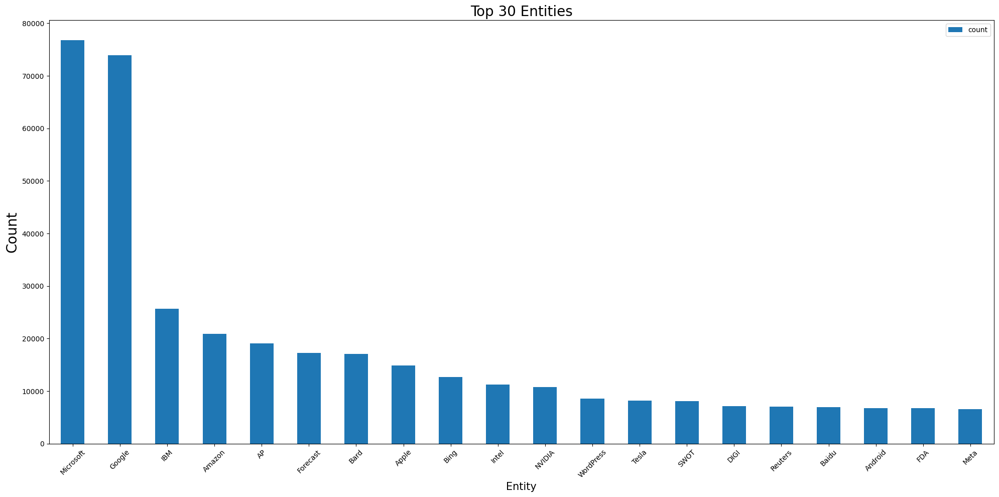

In [145]:
# plot the top 20 entities
df_entity_count.head(20).plot.bar(x='entity', y='count', figsize=(20,10))
# rotate the xticks
plt.xticks(rotation=45)
plt.title('Top 30 Entities', fontsize=20)

plt.ylabel('Count', fontsize=20)
plt.xlabel('Entity', fontsize=15)

# romove overlapping labels
plt.tight_layout()

# What they can do:

In [146]:
postive_sentiment.shape

(85765, 14)

In [147]:
# filter out rows that entities colomn does not contain entities in df_entity_count['entity'].head(30) in postive_sentiment
postive_sentiment = postive_sentiment[postive_sentiment['entities'].apply(lambda x: any(entity in x for entity in df_entity_count['entity'].head(30)))]
postive_sentiment.shape

(40081, 14)

In [148]:
postive_sentiment.head(1)

,url,date,language,title,text,split,split_cleaned,missing,text_cleaned,polarity,subjectivity,sentiment,entities,sentiment_agg
3,http://www.homeoffice.consumerelectronicsnet.com/strategy-analytics-71-of-smartphones-sold-globally-in-2021-will-be-ai-powered/,2021-03-10,en,Strategy Analytics: 71% of Smartphones Sold Globally in 2021 will be AI Powered – Consumer Electronics Net,Strategy Analytics 71 of Smartphones Sold Globally in 2021 will be AI Powered Consumer Electronics Net Skip to content Consumer Electronics Net Primary Menu Consumer Electronics Net Se...,[ Strategy Analytics 71 of Smartphones Sold Globally in 2021 will be AI Powered Consumer Electronics Net Skip to content Consumer Electronics Net Primary Menu Consumer Electronics Net S...,"[ Smartphones Global Artificial Intelligence Technologies Forecast to 2025, finds that on device Artificial Intelligence (AI) is being rapidly implemented by smartphone vendors AI is used in va...",[ Strategy Analytics 71 of Smartphones Sold Globally in 2021 will be AI Powered Consumer Electronics Net Skip to content Consumer Electronics Net Primary Menu Consumer Electronics Net S...,Smartphones Global Artificial Intelligence Technologies Forecast to 2025 finds that on device Artificial Intelligence (AI) is being rapidly implemented by smartphone vendors AI is used in various ...,0.163568,0.480095,"[POSITIVE, POSITIVE, POSITIVE, POSITIVE, POSITIVE, POSITIVE, POSITIVE, NEGATIVE]","[Artificial Intelligence, AI, AI, Edge AI, AI, AI, Augmented Reality, Modern, AI, Artificial Intelligence, Google, AI, Google, Apple, AI, Apple s Neural Engine, Qualcomm Neural Processing Engine, ...",POSITIVE


In [149]:
%%time
#apply ktrain.text.text_classifier to postive_sentiment['text_cleaned']
texts = postive_sentiment['text_cleaned'].tolist()

tm = ktrain.text.get_topic_model(
    texts=texts, 
    n_topics=12, 
    n_features=10000, 
    min_df=5, 
    max_df=0.5, 
    stop_words='english', 
    model_type='lda', 
    lda_max_iter=5, 
    verbose=1)

lang: en
preprocessing texts...
fitting model...
iteration: 1 of max_iter: 5
iteration: 2 of max_iter: 5
iteration: 3 of max_iter: 5
iteration: 4 of max_iter: 5
iteration: 5 of max_iter: 5
done.
Wall time: 2min 27s


In [150]:
%%time
tm.print_topics()

topic 0 | edge smart iot digi communications devices hardware power chip software
topic 1 | gray media prnewswire nvidia press release solutions platform statements said
topic 2 | health healthcare clinical care medicine ein patient medical patients presswire
topic 3 | like video users time language google search best use people
topic 4 | vision computer health recognition robots robotics conference university people awards
topic 5 | report analysis forecast key players trends size opportunities revenue software
topic 6 | learning machine science platform analytics education models cloud use model
topic 7 | medical imaging healthcare radiology cancer clinical patients gray patient lunit
topic 8 | customer cloud platform digital customers solutions service experience conversational security
topic 9 | said chatgpt year tech microsoft india policy privacy students use
topic 10 | policy travel public american transportation aviation sports real mining beverages
topic 11 | let state work un

In [151]:
%%time
#### Compute the Document-Topic Matrix
tm.build(texts, threshold=0.25)

done.
Wall time: 30.6 s


In [152]:
%%time
#### Inspect and Visualize Topics
# Let's list the topics by document count:

tm.print_topics(show_counts=True)

topic:5 | count:13131 | report analysis forecast key players trends size opportunities revenue software
topic:9 | count:4714 | said chatgpt year tech microsoft india policy privacy students use
topic:1 | count:4545 | gray media prnewswire nvidia press release solutions platform statements said
topic:3 | count:4101 | like video users time language google search best use people
topic:8 | count:3628 | customer cloud platform digital customers solutions service experience conversational security
topic:10 | count:3122 | policy travel public american transportation aviation sports real mining beverages
topic:2 | count:1822 | health healthcare clinical care medicine ein patient medical patients presswire
topic:7 | count:1365 | medical imaging healthcare radiology cancer clinical patients gray patient lunit
topic:6 | count:1351 | learning machine science platform analytics education models cloud use model
topic:0 | count:923 | edge smart iot digi communications devices hardware power chip soft

In [153]:
%%time
#### Visualize topics
doc_topics=tm.get_doctopics()

Wall time: 57 ms


In [154]:
%%time
tm.visualize_documents(doc_topics=tm.get_doctopics())

reducing to 2 dimensions...[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 39884 samples in 0.125s...
[t-SNE] Computed neighbors for 39884 samples in 5.651s...
[t-SNE] Computed conditional probabilities for sample 1000 / 39884
[t-SNE] Computed conditional probabilities for sample 2000 / 39884
[t-SNE] Computed conditional probabilities for sample 3000 / 39884
[t-SNE] Computed conditional probabilities for sample 4000 / 39884
[t-SNE] Computed conditional probabilities for sample 5000 / 39884
[t-SNE] Computed conditional probabilities for sample 6000 / 39884
[t-SNE] Computed conditional probabilities for sample 7000 / 39884
[t-SNE] Computed conditional probabilities for sample 8000 / 39884
[t-SNE] Computed conditional probabilities for sample 9000 / 39884
[t-SNE] Computed conditional probabilities for sample 10000 / 39884
[t-SNE] Computed conditional probabilities for sample 11000 / 39884
[t-SNE] Computed conditional probabilities for sample 12000 / 39884
[t-SNE] Computed condit

Loading BokehJS ...

Wall time: 1min 32s


# Leverage appropriate NLP techniques to identify organizations, people and locations, then apply targeted sentiment
    -What types of companies (based on the lines of business) should invest in data science initiatives today or near future (success stories)?
 Create appropriate visualization to summarize your recommendations (i.e. word cloud chart or bubble chart)

    -What types of applications cannot currently be transformed by AI, based on today's state of technology (failures)?
Create appropriate visualization to summarize your recommendations (i.e. word cloud chart or bubble chart)

1. for 'should', check positive sentiment ners
2. for 'cannot', check negative sentiment ners

(Use targeted setiment)

In [15]:
%%time
# read df_top_tfidf_sentiment parquet file
df_top_tfidf_sentiment = pd.read_parquet('df_ready', engine='pyarrow')

Wall time: 2min 18s


In [16]:
postive_sentiment = df_top_tfidf_sentiment[df_top_tfidf_sentiment['sentiment_agg'] == 'POSITIVE']
negative_sentiment = df_top_tfidf_sentiment[df_top_tfidf_sentiment['sentiment_agg'] == 'NEGATIVE']

In [17]:
# save both postive_sentiment and negative_sentiment as parquet files
postive_sentiment.to_parquet('postive_sentiment', engine='pyarrow')
negative_sentiment.to_parquet('negative_sentiment', engine='pyarrow')

# for success:

In [87]:
df_entity_count=[]

In [88]:
# read postive_sentiment parquet file
postive_sentiment = pd.read_parquet('postive_sentiment', engine='pyarrow')

In [89]:
postive_sentiment['entities']

0         [[Chinese, NORP], [Chinese, NORP], [Japanese, ...
3         [[2025, DATE], [Artificial Intelligence, ORG],...
4         [[20 2020, DATE], [ACN Newswire, ORG], [Olympu...
7         [[the CEVAnet Partner Program, ORG], [CEVA, PR...
8         [[Applitools Visual AI Reaches One Billion Ima...
                                ...                        
200321    [[iMerit Launches New Self Serve API Tool, ORG...
200322    [[2021, DATE], [10 48 AM EST, TIME], [46 minut...
200324    [[Drift Introduces GPT Integration, ORG], [Sel...
200327    [[al tunnel, PERSON], [71, CARDINAL], [2077, D...
200329    [[Heres, ORG], [George Anadiotis, PERSON], [De...
Name: entities, Length: 85765, dtype: object

In [90]:
entity_types = set()
for sublist in postive_sentiment['entities']:
    for pair in sublist:
        entity_type = pair[1]
        entity_types.add(entity_type)

print(entity_types)

{'NORP', 'LAW', 'MONEY', 'TIME', 'EVENT', 'ORG', 'CARDINAL', 'ORDINAL', 'PERSON', 'PRODUCT', 'LANGUAGE', 'WORK_OF_ART', 'GPE', 'DATE', 'PERCENT', 'QUANTITY', 'LOC', 'FAC'}


In [91]:
# keep ORG, GPE, PRODUCT, LOC, PERSON, FAC in the entities column
postive_sentiment['entities'] = postive_sentiment['entities'].apply(lambda x: [pair for pair in x if pair[1] in ['ORG']])

entity_types = set()
for sublist in postive_sentiment['entities']:
    for pair in sublist:
        entity_type = pair[1]
        entity_types.add(entity_type)

print(entity_types)

{'ORG'}


In [92]:
# get top 20 entities for 'ORG'
postive_sentiment['entities'] = postive_sentiment['entities'].apply(lambda x: [pair[0] for pair in x])

# get the count for each entity
entity_count = Counter([entity for sublist in postive_sentiment['entities'] for entity in sublist])

# create a dataframe
df_entity_count = pd.DataFrame({'entity': entity_count.keys(), 'count': entity_count.values()})

# sort the dataframe by count
df_entity_count = df_entity_count.sort_values(by='count', ascending=False)

In [93]:
# combine Gray Television Inc,Gray Media Group,Gray Media Group Inc Station, and Gray Media Group Inc to Gray Media Group (same row)
df_entity_count.loc[df_entity_count['entity'] == 'Gray Television Inc', 'entity'] = 'Gray Media Group'
df_entity_count.loc[df_entity_count['entity'] == 'Gray Media Group Inc Station', 'entity'] = 'Gray Media Group'
df_entity_count.loc[df_entity_count['entity'] == 'Gray Media Group Inc', 'entity'] = 'Gray Media Group'

# make all Gray Media Group to a single row
df_entity_count = df_entity_count.groupby('entity').sum().reset_index()

In [119]:
# remove AI
df_entity_count = df_entity_count[df_entity_count['entity'] != 'AI']
#remove Artificial Intelligence	
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Artificial Intelligence']
#remove ml
df_entity_count = df_entity_count[df_entity_count['entity'] != 'ml']
#remove ML
df_entity_count = df_entity_count[df_entity_count['entity'] != 'ML']
#remove machine learning
df_entity_count = df_entity_count[df_entity_count['entity'] != 'machine learning']
#remove U S
df_entity_count = df_entity_count[df_entity_count['entity'] != 'U S']
#remove EU
df_entity_count = df_entity_count[df_entity_count['entity'] != 'EU']
#remove COVID
df_entity_count = df_entity_count[df_entity_count['entity'] != 'COVID']
#remove Trump
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Trump']
#remove Musk
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Musk']
#remove Elon Musk
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Elon Musk']
#remove the Artificial Intelligence
df_entity_count = df_entity_count[df_entity_count['entity'] != 'the Artificial Intelligence']
#remove the API
df_entity_count = df_entity_count[df_entity_count['entity'] != 'API']
#remove the GPU
df_entity_count = df_entity_count[df_entity_count['entity'] != 'GPU']
#remove the NLP
df_entity_count = df_entity_count[df_entity_count['entity'] != 'NLP']
#remove the AI ML
df_entity_count = df_entity_count[df_entity_count['entity'] != 'AI ML']
#remove the GPT
df_entity_count = df_entity_count[df_entity_count['entity'] != 'GPT']
#remove the Healthcare
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Healthcare']
#remove the IP
df_entity_count = df_entity_count[df_entity_count['entity'] != 'IP']
#remove the Gray Media Group, PRNewswire, WordPress, Machine Learning, Media, Group, Gray
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Gray Media Group']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'PRNewswire']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'WordPress']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Machine Learning']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Media']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Group']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Gray']
#remove Services, Privacy
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Services']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Privacy']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Beverages']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Services']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Personal']

In [120]:
# sort df_entity_count by count
df_entity_count = df_entity_count.sort_values(by='count', ascending=False)
df_entity_count.head(30)

,entity,count
175474,IBM,16139
227888,Microsoft,16010
131505,Forecast,12531
159808,Google,7825
237014,NVIDIA,7136
292627,SWOT,6218
188053,Intel,5597
28574,Amazon,4669
187103,Inspection Filepublicfile,3803
190917,IoT,3652


In [121]:
# make a list of top 30 entities
top_30_entities_po = df_entity_count['entity'].head(30).tolist()

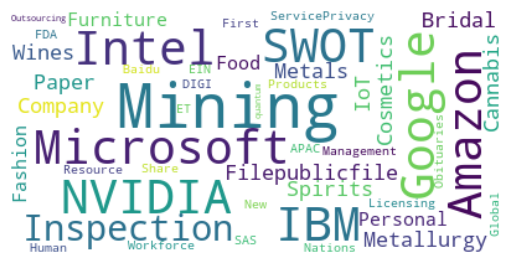

In [133]:
wordcloud = WordCloud(max_font_size=50, max_words=100, background_color="white").generate(' '.join(df_entity_count.head(25)['entity'].
                                                                                                   apply(lambda x: x.replace('Artificial', '')
                                                                                                         .replace('Intelligence', '')
                                                                                                         .replace('Forecast', '')
                                                                                                         .replace('Care ', '')
                                                                                                         .replace('Wines ', '')
                                                                                                         .replace('Services', '')
                                                                                                         .replace('Beverages', ''))))

plt.figure()
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

In [90]:
postive_sentiment.shape

(85765, 14)

In [91]:
# filter out rows that entities colomn does not contain entities in df_entity_count['entity'].head(30) in postive_sentiment
postive_sentiment1 = postive_sentiment[postive_sentiment['entities'].apply(lambda x: any(entity in x for entity in df_entity_count['entity'].head(30)))]
postive_sentiment1.shape

(42544, 14)

# For failures: 

In [15]:
%%time
# read negative_sentiment parquet file
negative_sentiment = pd.read_parquet('negative_sentiment', engine='pyarrow')

Wall time: 16.6 s


<AxesSubplot:>

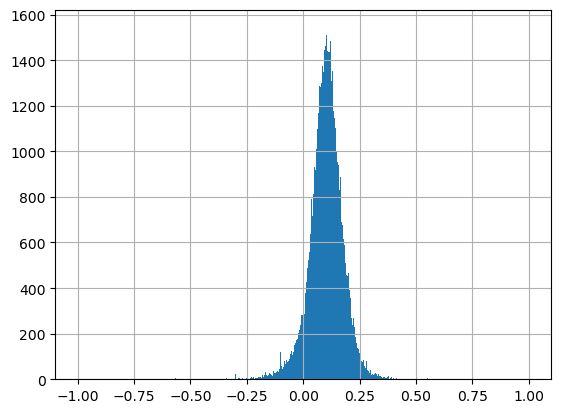

In [16]:
# plot the sentiment distribution based on polarity
negative_sentiment['polarity'].hist(bins=1000)

<AxesSubplot:>

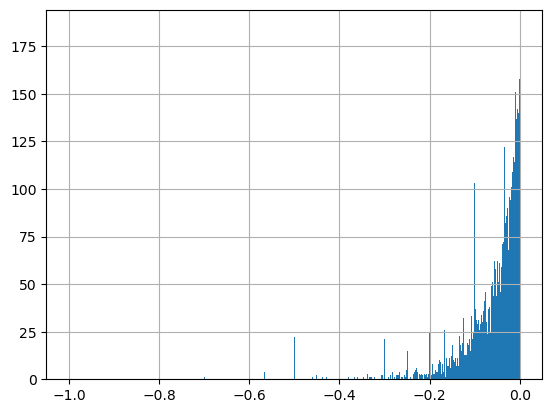

In [17]:
# keep polarity between less than 0
negative_sentiment = negative_sentiment[negative_sentiment['polarity'] < 0]
# plot the sentiment distribution based on polarity
negative_sentiment['polarity'].hist(bins=1000)

In [18]:
df_entity_count=[]

In [19]:
%%time
negative_sentiment['entities']

Wall time: 0 ns


15        [[EU, ORG], [Artificial Intelligence Video ABC...
20        [[Artificial Intelligence in Video Games Marke...
21        [[Artificial Intelligence in Medicine Market T...
33        [[Artificial Intelligence (AI, ORG], [the Frei...
65        [[COVID 19Finance Ministry, ORG], [one, CARDIN...
                                ...                        
200177    [[2021, DATE], [The United States, GPE], [near...
200183    [[Chinese, NORP], [White HouseDeliveroo, ORG],...
200253    [[10 12, CARDINAL], [12, CARDINAL], [Delhi, GP...
200270    [[WKMS, ORG], [WKMS, ORG], [Contact Us eNewsle...
200275    [[Twitter Share on Facebook Share on LinkedIn ...
Name: entities, Length: 8449, dtype: object

In [20]:
%%time
entity_types = set()
for sublist in negative_sentiment['entities']:
    for pair in sublist:
        entity_type = pair[1]
        entity_types.add(entity_type)

print(entity_types)

{'NORP', 'LAW', 'MONEY', 'EVENT', 'TIME', 'ORG', 'CARDINAL', 'ORDINAL', 'PERSON', 'PRODUCT', 'LANGUAGE', 'WORK_OF_ART', 'GPE', 'FAC', 'DATE', 'QUANTITY', 'LOC', 'PERCENT'}
Wall time: 82.7 ms


In [21]:
# keep only ORG
negative_sentiment['entities'] = negative_sentiment['entities'].apply(lambda x: [pair for pair in x if pair[1] in ['ORG']])

entity_types = set()
for sublist in negative_sentiment['entities']:
    for pair in sublist:
        entity_type = pair[1]
        entity_types.add(entity_type)

print(entity_types)

{'ORG'}


In [22]:
%%time
# get top 20 entities for 'ORG'
negative_sentiment['entities'] = negative_sentiment['entities'].apply(lambda x: [pair[0] for pair in x])

# get the count for each entity
entity_count = Counter([entity for sublist in negative_sentiment['entities'] for entity in sublist])

# create a dataframe
df_entity_count = pd.DataFrame({'entity': entity_count.keys(), 'count': entity_count.values()})

# sort the dataframe by count
df_entity_count = df_entity_count.sort_values(by='count', ascending=False)

Wall time: 88.2 ms


In [23]:
# combine Gray Television Inc,Gray Media Group,Gray Media Group Inc Station, and Gray Media Group Inc to Gray Media Group (same row)
df_entity_count.loc[df_entity_count['entity'] == 'Gray Television Inc', 'entity'] = 'Gray Media Group'
df_entity_count.loc[df_entity_count['entity'] == 'Gray Media Group Inc Station', 'entity'] = 'Gray Media Group'
df_entity_count.loc[df_entity_count['entity'] == 'Gray Media Group Inc', 'entity'] = 'Gray Media Group'

# make all Gray Media Group to a single row
df_entity_count = df_entity_count.groupby('entity').sum().reset_index()

In [71]:
# remove irrelevant entities
df_entity_count = df_entity_count[df_entity_count['entity'] != 'AI']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Artificial Intelligence']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Intelligence']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'ml']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'ML']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'machine learning']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'U S']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'EU']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'COVID']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Trump']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Musk']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Elon Musk']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'the Artificial Intelligence']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'API']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'GPU']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'NLP']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'AI ML']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'GPT']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Healthcare']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'IP']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Gray Media Group']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'PRNewswire']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'WordPress']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Machine Learning']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Media']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Group']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Gray']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Services']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Privacy']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Intelligence ']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Artificial ']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Associated']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Press']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Service Privacy']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Privacy']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Service']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'Artificial Intelligence']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'AI']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'X']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'x']
df_entity_count = df_entity_count[df_entity_count['entity'] != 'The Artificial Intelligence	']

In [72]:
# sort df_entity_count by count
df_entity_count = df_entity_count.sort_values(by='count', ascending=False)
df_entity_count.head(30)

,entity,count
25732,Google,2469
36323,Microsoft,1990
21426,Forecast,1846
28075,IBM,1615
23351,Global Artificial Intelligence,783
46261,SWOT,736
9717,Bard,664
1785,AP,645
25609,Global X Robotics Artificial Intelligence,555
21010,First Trust Nasdaq Artificial Intelligence,533


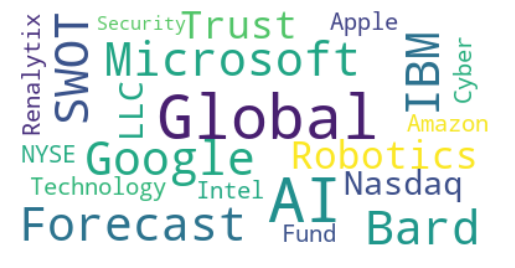

In [86]:
# create a word cloud for entities df_entity_count['entity']

wordcloud = WordCloud(max_font_size=50, max_words=100, background_color="white").generate(' '.join(df_entity_count.head(20)['entity'].
                                                                                                   apply(lambda x: x.replace('Artificial', '')
                                                                                                         .replace('Intelligence', '')
                                                                                                         .replace('X ', '')
                                                                                                         .replace('LLC ', '')
                                                                                                         .replace('First ', '')
                                                                                                         .replace('AP', '')
                                                                                                         .replace('Opportunities', ''))))

# Display the generated image:

plt.figure()
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [25]:
negative_sentiment.shape

(112249, 14)

In [51]:
# filter out rows that entities colomn does not contain entities in df_entity_count['entity'].head(30) in negative_sentiment
negative_sentiment1 = negative_sentiment[negative_sentiment['entities'].apply(lambda x: any(entity in x for entity in df_entity_count['entity'].head(30)))]
negative_sentiment1.shape

(4346, 14)